# <p><center style="font-family:newtimeroman;font-size:180%;"> Plant Village Disease Classification </center></p>
### Table of contents:

* [Import Libraries](#1)
* [Read Data](#2)
* [Visualization Of Dataset](#3)
* [Data Augmentation](#4)
* [Train CNN Model](#5)
* [Evaluate The Model](#6)

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [1]:
import os 
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import keras 
from keras.callbacks import EarlyStopping,ModelCheckpoint
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tqdm import tqdm

**<a id="2"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Read Data </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [2]:
def data(dataset_path):
    images = []
    labels = []
    for subfolder in tqdm(os.listdir(dataset_path)):
        subfolder_path = os.path.join(dataset_path, subfolder)
        for image_filename in os.listdir(subfolder_path):
            image_path = os.path.join(subfolder_path, image_filename)
            images.append(image_path)
            labels.append(subfolder)
    df = pd.DataFrame({'image': images, 'label': labels})
    return df

In [3]:
#train
train = data('/kaggle/input/plantvillage-dataset/color')
train.head()

100%|██████████| 38/38 [00:03<00:00, 12.49it/s]


,image,label
0,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
1,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
2,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
3,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
4,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight


In [4]:
train.shape

(54305, 2)

**<a id="3"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Visualization of Dataset </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [5]:
train.label.value_counts().to_frame()

,count
label,
Orange___Haunglongbing_(Citrus_greening),5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus,5357
Soybean___healthy,5090
Peach___Bacterial_spot,2297
Tomato___Bacterial_spot,2127
Tomato___Late_blight,1909
Squash___Powdery_mildew,1835
Tomato___Septoria_leaf_spot,1771
Tomato___Spider_mites Two-spotted_spider_mite,1676


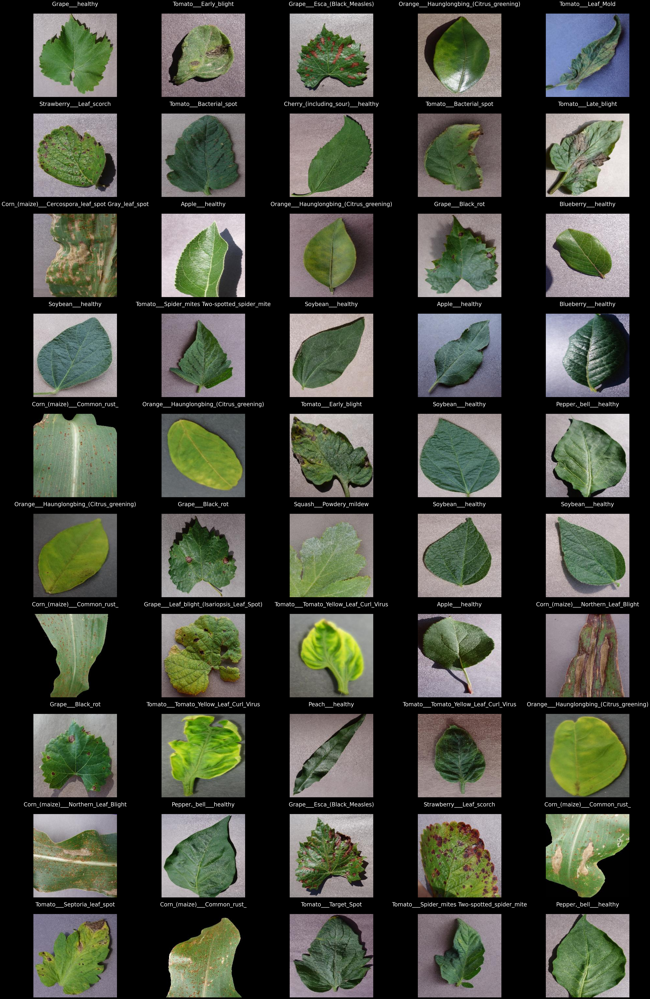

In [6]:
plt.style.use('dark_background')
plt.figure(figsize=(50,80))
for n,i in enumerate(np.random.randint(0,len(train),50)):
    plt.subplot(10,5,n+1)
    img = cv2.imread(train.image[i])
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    text = f'{train.label[i]}\n'
    plt.title(text,fontsize=25)

<a id="4"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Data Augmentation </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [7]:
X_train, X_test1, y_train, y_test1 = train_test_split(train['image'], train['label'], test_size=0.2, random_state=42,shuffle=True,stratify=train['label'])
X_val, X_test, y_val, y_test = train_test_split(X_test1,y_test1, test_size=0.5, random_state=42,shuffle=True,stratify=y_test1)
df_train = pd.DataFrame({'image': X_train, 'label': y_train})
df_test = pd.DataFrame({'image': X_test, 'label': y_test})
df_val = pd.DataFrame({'image': X_val, 'label': y_val})

In [8]:
image_size = (224, 224)
batch_size = 32
datagen = ImageDataGenerator(
    rescale=1./255
)
train_datagen = ImageDataGenerator(
    rescale=1./255, 
    #rotation_range=20,
    #width_shift_range=0.2,
    #height_shift_range=0.2,
    #shear_range=0.2,
    #zoom_range=0.2,
    horizontal_flip=True,
    #fill_mode='nearest'
)
train_generator = train_datagen.flow_from_dataframe(
    df_train,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=True
)
test_generator = datagen.flow_from_dataframe(
    df_test,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)
val_generator = datagen.flow_from_dataframe(
    df_val,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)

Found 43444 validated image filenames belonging to 38 classes.
Found 5431 validated image filenames belonging to 38 classes.
Found 5430 validated image filenames belonging to 38 classes.


In [9]:
class_ = test_generator.class_indices.keys()
class_ = list(class_)

<a id="5"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Modeling </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [10]:
model = keras.models.Sequential([
    keras.layers.Conv2D(32, kernel_size = (3,3), activation = 'relu', input_shape = (224,224,3)),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'),
    keras.layers.MaxPooling2D(2,2),
    
    keras.layers.Flatten(), 
    
    keras.layers.Dense(64, activation='relu'),
    
    keras.layers.Dense(38, activation='softmax'),
    
])
model.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 24, 24, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 12, 12, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 5, 5, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 3, 3, 64)       │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 1, 1, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38)             │         2,470 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 173,734 (678.65 KB)

 Trainable params: 173,734 (678.65 KB)

 Non-trainable params: 0 (0.00 B)

In [11]:
checkpoint_cb =ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.AUC()])
hist=model.fit(train_generator,epochs=20,validation_data=val_generator,callbacks=[checkpoint_cb,early_stopping_cb])

Epoch 1/20


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1728417831.792803      73 service.cc:145] XLA service 0x7de8cc0024b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1728417831.792859      73 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


   1/1358 ━━━━━━━━━━━━━━━━━━━━ 3:40:30 10s/step - accuracy: 0.0312 - auc: 0.5000 - loss: 3.6420

I0000 00:00:1728417837.649286      73 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1358/1358 ━━━━━━━━━━━━━━━━━━━━ 310s 221ms/step - accuracy: 0.2644 - auc: 0.8106 - loss: 2.7436 - val_accuracy: 0.6101 - val_auc: 0.9669 - val_loss: 1.2751
Epoch 2/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 138s 101ms/step - accuracy: 0.6845 - auc: 0.9778 - loss: 1.0408 - val_accuracy: 0.7722 - val_auc: 0.9880 - val_loss: 0.7182
Epoch 3/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 137s 100ms/step - accuracy: 0.8037 - auc: 0.9901 - loss: 0.6277 - val_accuracy: 0.8628 - val_auc: 0.9958 - val_loss: 0.4222
Epoch 4/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 134s 99ms/step - accuracy: 0.8521 - auc: 0.9939 - loss: 0.4637 - val_accuracy: 0.8716 - val_auc: 0.9950 - val_loss: 0.3979
Epoch 5/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 134s 98ms/step - accuracy: 0.8736 - auc: 0.9948 - loss: 0.3893 - val_accuracy: 0.8709 - val_auc: 0.9952 - val_loss: 0.4022
Epoch 6/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 132s 97ms/step - accuracy: 0.8969 - auc: 0.9966 - loss: 0.3142 - val_accuracy: 0.8775 - val_auc: 0.9944 - val_loss: 0.3737
Epoch 7/20
1358/13

<a id="6"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate The Model  </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [12]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,auc,loss,val_accuracy,val_auc,val_loss
0,0.408871,0.904513,2.132638,0.610129,0.966878,1.275100
1,0.720399,0.982059,0.911544,0.772192,0.987999,0.718228
2,0.813392,0.991010,0.590858,0.862799,0.995802,0.422233
3,0.857057,0.994059,0.446551,0.871639,0.995030,0.397885
4,0.878050,0.995061,0.376797,0.870902,0.995235,0.402247
5,0.898099,0.996408,0.314539,0.877532,0.994377,0.373668
6,0.909654,0.996436,0.279923,0.919337,0.997449,0.247289
7,0.919575,0.997201,0.243448,0.911050,0.995647,0.283428
8,0.924800,0.997430,0.231479,0.914549,0.997366,0.250382
9,0.930784,0.997868,0.204445,0.928913,0.997209,0.217708


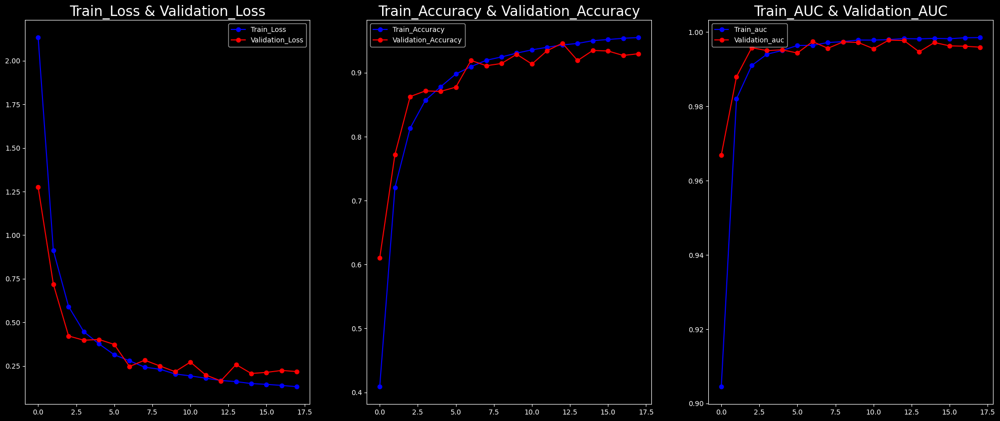

In [13]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
plt.plot(hist_['loss'],'b-o',label='Train_Loss')
plt.plot(hist_['val_loss'],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(1,3,2)
plt.plot(hist_['accuracy'],'b-o',label='Train_Accuracy')
plt.plot(hist_['val_accuracy'],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(1,3,3)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [14]:
score, acc,auc = model.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test AUC =', auc)

  2/170 ━━━━━━━━━━━━━━━━━━━━ 11s 71ms/step - accuracy: 0.9297 - auc: 0.9996 - loss: 0.1765 

/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


170/170 ━━━━━━━━━━━━━━━━━━━━ 34s 198ms/step - accuracy: 0.9377 - auc: 0.9978 - loss: 0.1794
Test Loss = 0.17970013618469238
Test Accuracy = 0.9396059513092041
Test AUC = 0.9974273443222046


In [15]:
# Get true labels
y_test = test_generator.classes
# Predict probabilities for each class
predictions = model.predict(test_generator)
# Convert predicted probabilities to class labels (choose the class with the highest probability)
y_pred = np.argmax(predictions, axis=1)
# Flatten both arrays just in case
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
# Create a DataFrame to compare actual vs predicted labels
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
# Display the DataFrame
df.head()  # Show the first few rows of the comparison

170/170 ━━━━━━━━━━━━━━━━━━━━ 13s 74ms/step


,Actual,Prediction
0,1,1
1,17,17
2,24,24
3,19,15
4,31,31


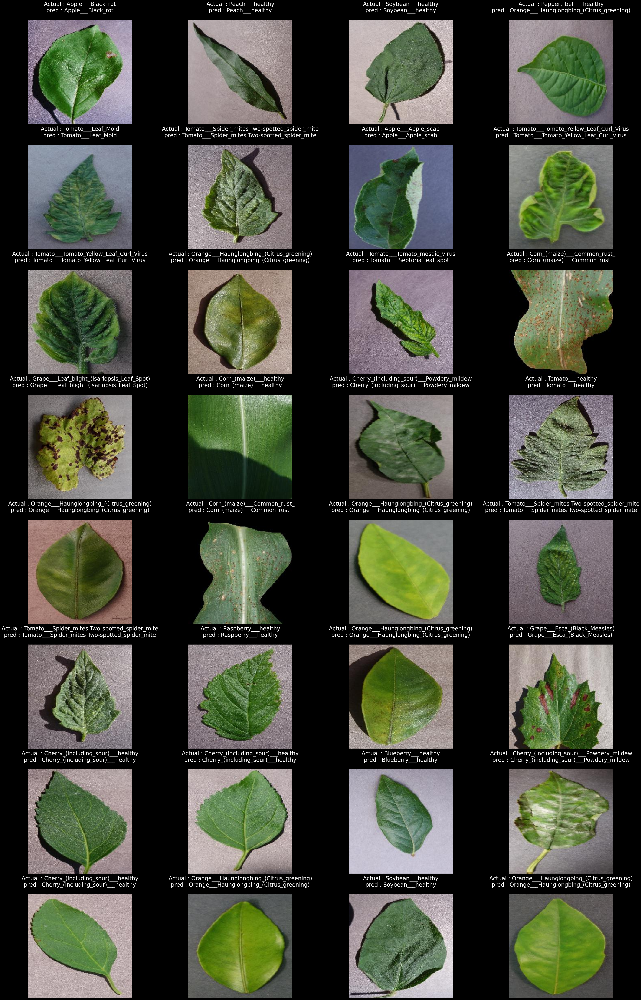

In [16]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,80))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    text = f'Actual : {class_[int(y_test[n])]}\npred : {class_[int(y_pred[n])]}\n'
    plt.title(text,fontsize=25)

array([[ 57,   1,   0, ...,   0,   0,   0],
       [  0,  58,   0, ...,   0,   0,   0],
       [  0,   0,  23, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ..., 533,   0,   0],
       [  0,   0,   0, ...,   0,  32,   0],
       [  0,   0,   0, ...,   0,   0, 156]])

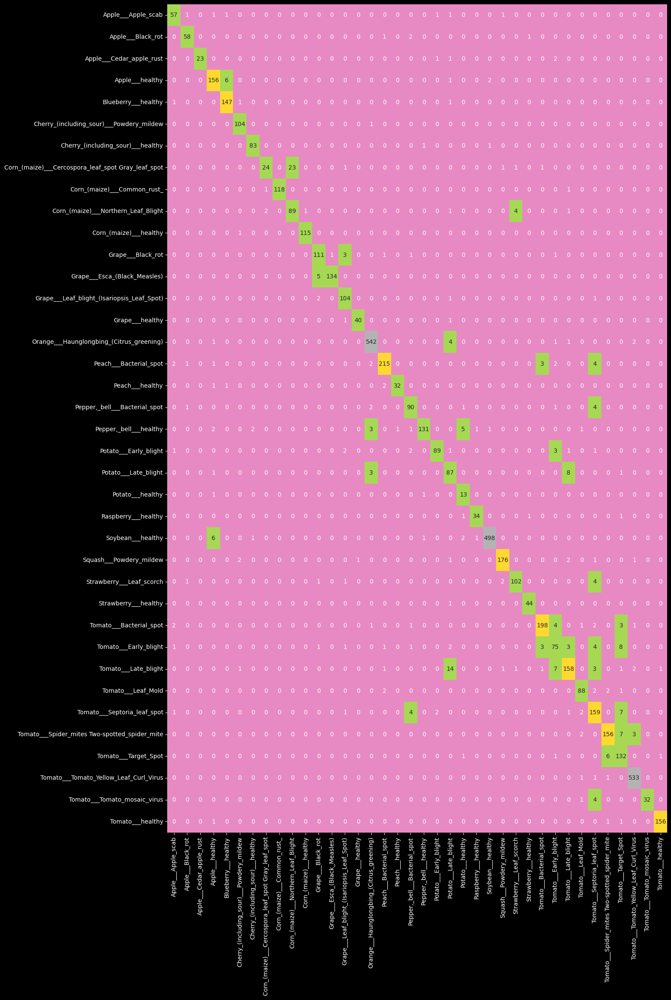

In [17]:
CM = confusion_matrix(y_test,y_pred)
plt.figure(figsize=(15,25))
sns.heatmap(CM,fmt='g',center = True,cbar=False,annot=True,cmap='Set2',xticklabels=class_,yticklabels=class_)
CM

In [18]:
ClassificationReport = classification_report(y_test,y_pred,target_names=class_)
print('Classification Report is : ', ClassificationReport)

Classification Report is :                                                      precision    recall  f1-score   support

                                Apple___Apple_scab       0.88      0.90      0.89        63
                                 Apple___Black_rot       0.94      0.94      0.94        62
                          Apple___Cedar_apple_rust       1.00      0.85      0.92        27
                                   Apple___healthy       0.91      0.95      0.93       165
                               Blueberry___healthy       0.95      0.98      0.96       150
          Cherry_(including_sour)___Powdery_mildew       0.95      0.99      0.97       105
                 Cherry_(including_sour)___healthy       0.97      0.98      0.97        85
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.89      0.47      0.62        51
                       Corn_(maize)___Common_rust_       1.00      0.98      0.99       120
               Corn_(maize)___Northern_Leaf_Blight 